# 1. Inference Tutorial
- 레퍼런스 코드의 추론 튜토리얼

In [ ]:
# !pip install -r https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt

In [ ]:
import cv2
import torch
from PIL import Image

# 모델 선택
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')
# model = torch.hub.load('ultralytics/yolov5', 'yolov5x6', device='cpu')  # load on CPU
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', _verbose=False)  # load silently
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', channels=4)
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', classes=10)
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', force_reload=True)  # force reload

# 예시 이미지
for f in 'zidane.jpg', 'bus.jpg':
    torch.hub.download_url_to_file('https://ultralytics.com/images/' + f, f)  # download 2 images
im1 = Image.open('zidane.jpg')  # PIL image
im2 = cv2.imread('bus.jpg')[..., ::-1]  # OpenCV image (BGR to RGB)

/usr/local/lib/python3.9/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2023-4-18 Python-3.9.16 torch-2.0.0+cu118 CPU



requirements: /root/.cache/torch/hub/requirements.txt not found, check failed.


100%|██████████| 270M/270M [00:02<00:00, 134MB/s]

Fusing layers... 
YOLOv5x6 summary: 574 layers, 140730220 parameters, 0 gradients
Adding AutoShape... 
100%|██████████| 165k/165k [00:00<00:00, 38.1MB/s]
100%|██████████| 476k/476k [00:00<00:00, 53.8MB/s]


In [ ]:
# Inference
results = model([im1, im2], size=640) # batch of images

# Results
results.print()  
results.save()  # or .show()

results.xyxy[0]  # im1 predictions (tensor)
results.pandas().xyxy[0]  # im1 predictions (pandas)
#      xmin    ymin    xmax   ymax  confidence  class    name
# 0  749.50   43.50  1148.0  704.5    0.874023      0  person
# 1  433.50  433.50   517.5  714.5    0.687988     27     tie
# 2  114.75  195.75  1095.0  708.0    0.624512      0  person
# 3  986.00  304.00  1028.0  420.0    0.286865     27     tie

image 1/2: 720x1280 3 persons, 3 ties
image 2/2: 1080x810 4 persons, 1 bus
Speed: 25.9ms pre-process, 3709.8ms inference, 11.9ms NMS per image at shape (2, 3, 640, 640)
Saved 2 images to runs/detect/exp


,xmin,ymin,xmax,ymax,confidence,class,name
0,120.617981,198.358887,1149.350830,712.479370,0.948801,0,person
1,749.386292,40.999481,1146.882202,709.937744,0.934009,0,person
2,433.621277,437.003784,522.759766,716.897095,0.878458,27,tie
3,1098.989502,365.419800,1280.000000,714.207520,0.576132,0,person
4,982.703125,300.103821,1136.646729,700.334167,0.459836,27,tie
5,991.504028,312.651917,1039.922974,415.064392,0.456508,27,tie


In [ ]:
## customize inference settings

model.conf = 0.25  # NMS confidence threshold
model.iou = 0.45  # NMS IoU threshold
model.agnostic = False  # NMS class-agnostic
model.multi_label = False  # NMS multiple labels per box
model.classes = None  # (optional list) filter by class, i.e. = [0, 15, 16] for COCO persons, cats and dogs
model.max_det = 1000  # maximum number of detections per image
model.amp = False  # Automatic Mixed Precision (AMP) inference

results = model(im1, size=320)  # custom inference size

# Results
results.print()  
results.save()  # or .show()

results.xyxy[0]  # im1 predictions (tensor)
results.pandas().xyxy[0]  # im1 predictions (pandas)

image 1/1: 720x1280 2 persons, 2 ties
Speed: 3.7ms pre-process, 43.9ms inference, 1.9ms NMS per image at shape (1, 3, 192, 320)
Saved 1 image to runs/detect/exp2


,xmin,ymin,xmax,ymax,confidence,class,name
0,104.007690,199.945953,1155.244263,716.879761,0.915529,0,person
1,740.765076,39.999939,1157.838623,715.714172,0.900445,0,person
2,425.453827,433.221252,521.273865,715.665466,0.639493,27,tie
3,987.838867,310.506836,1030.190308,419.357788,0.350986,27,tie


In [ ]:
# Models can be transferred to any device after creation:
model.cpu()  # CPU
model.cuda()  # GPU
model.to(device)  # i.e. device=torch.device(0)

In [ ]:
# Multi GPUs
import torch
import threading

def run(model, im):
  results = model(im)
  results.save()

# Models
model0 = torch.hub.load('ultralytics/yolov5', 'yolov5s', device=0)
model1 = torch.hub.load('ultralytics/yolov5', 'yolov5s', device=1)

# Inference
threading.Thread(target=run, args=[model0, 'https://ultralytics.com/images/zidane.jpg'], daemon=True).start()
threading.Thread(target=run, args=[model1, 'https://ultralytics.com/images/bus.jpg'], daemon=True).start()

# 2. Training Tutorial
## Refers.
- https://docs.ultralytics.com/yolov5/pytorch_hub/#training
- https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data
- https://colab.research.google.com/github/ultralytics/yolov5/blob/master/tutorial.ipynb#scrollTo=ZY2VXXXu74w5
- https://docs.ultralytics.com/yolov5/train_custom_data/#2-select-a-model
- https://www.kaggle.com/code/ultralytics/yolov5/notebook



## Tips
- Add --cache ram or --cache disk to speed up training (requires significant RAM/disk resources).
- Always train from a local dataset. Mounted or network drives like Google Drive will be very slow.

In [ ]:
## 코랩 사용 시##
# from google.colab import drive
# drive.mount('/content/drive')

import os
os.chdir('/content/drive/MyDrive/semes/detection/main/yolov5-master')

# !pip install -r requirements_train_colab.txt
!pip install -r requirements_base.txt

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# train 모듈 import
import train

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

In [ ]:
# 학습 실행
!python train.py --img 640 --batch 16 --epochs 20 --data data/wheel.yaml --weights yolov5x.pt --hyp data/hyps/hyp.scratch-custom.yaml  --cache

train: weights=yolov5x.pt, cfg=, data=data/wheel.yaml, hyp=data/hyps/hyp.scratch-custom.yaml, epochs=20, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: skipping check (not a git repository), for updates see https://github.com/ultralytics/yolov5
requirements: /content/drive/MyDrive/semes/detection/main/requirements.txt not found, check failed.
YOLOv5 🚀 2023-4-18 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_

# 3. Inference Tutorial
- https://github.com/ultralytics/yolov5/discussions/5872
- https://github.com/ultralytics/yolov5/issues/36

In [4]:
import os
import torch
from PIL import Image

In [5]:
## 코랩 환경 시##
# from google.colab import drive
# drive.mount('/content/drive')

# os.chdir('/content/drive/MyDrive/semes/detection/main/yolov5-master')

In [6]:
# load model
model_path = 'weights/best.pt'
model = torch.hub.load('.', 'custom', path=model_path, source='local')

YOLOv5  2023-4-18 Python-3.9.13 torch-2.0.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1060, 6144MiB)



requirements: C:\Users\SSAFY\dev\pjt3\detection\requirements.txt not found, check failed.


Fusing layers... 
Model summary: 322 layers, 86173414 parameters, 0 gradients, 203.8 GFLOPs
Adding AutoShape... 


image 1/1: 3456x3456 11 bolt holes
Speed: 150.5ms pre-process, 139.5ms inference, 66.4ms NMS per image at shape (1, 3, 640, 640)


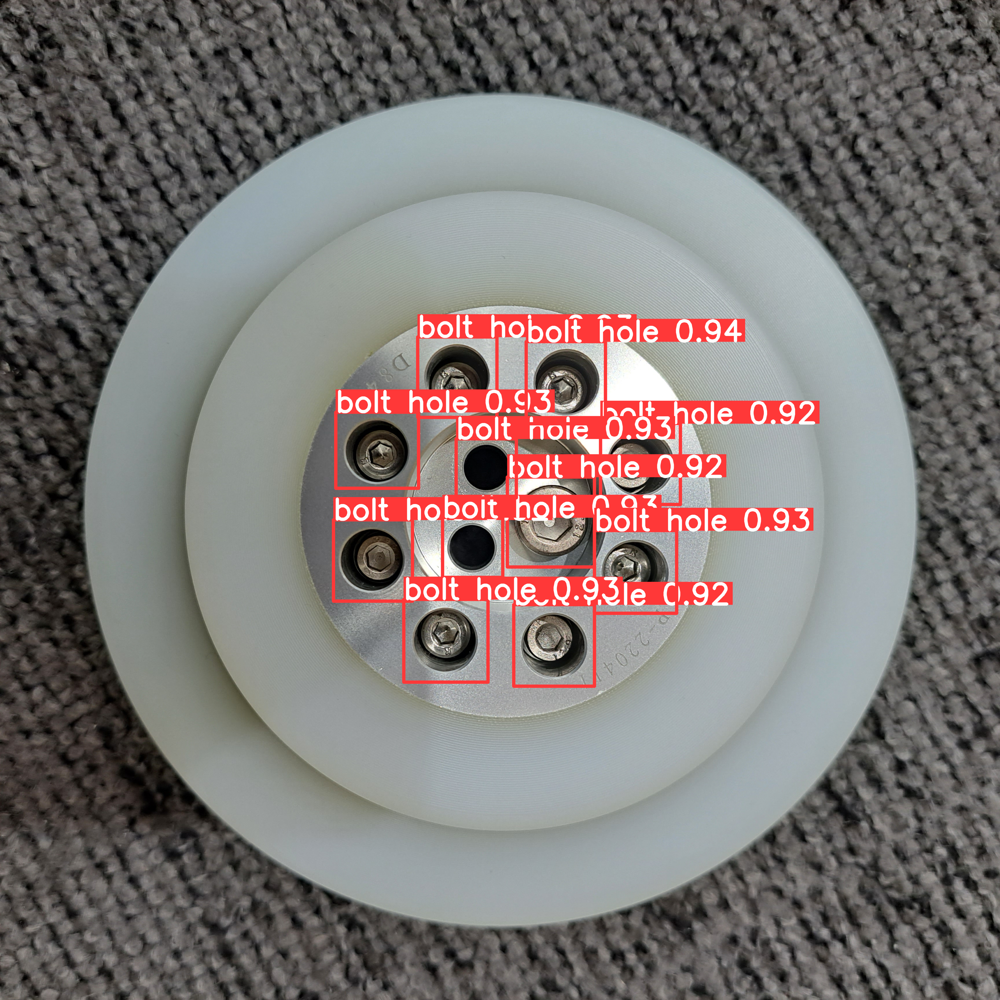

,xmin,ymin,xmax,ymax,confidence,class,name
0,1818.812866,1180.592529,2092.224854,1464.272095,0.936688,0,bolt hole
1,1395.277466,2071.297119,1686.541870,2357.678711,0.929174,0,bolt hole
2,1576.600098,1516.294434,1784.357422,1720.874146,0.927749,0,bolt hole
3,1160.965210,1424.978638,1446.623901,1687.174561,0.927332,0,bolt hole
4,2054.497070,1833.938599,2338.175049,2119.012695,0.927212,0,bolt hole
5,1529.260376,1788.777100,1737.422974,1995.946655,0.926287,0,bolt hole
6,1443.577148,1164.723633,1717.647949,1442.318848,0.925063,0,bolt hole
7,1775.008911,2089.032227,2054.951660,2371.289307,0.924507,0,bolt hole
8,1152.023193,1796.501831,1425.696045,2077.487061,0.921549,0,bolt hole
9,1753.264038,1648.720337,2054.058350,1959.913452,0.920315,0,bolt hole


In [7]:
image_path = 'images/'
image_list = os.listdir(image_path)
image = Image.open(image_path + image_list[0])

# 추론
results = model(image)

# 결과 출력
results.print()  
results.show()  # or .show()

results.xyxy[0]  # im1 predictions (tensor)
results.pandas().xyxy[0]  # im1 predictions (pandas)